In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc
import squidpy as sq

In [206]:
from scipy.stats import ttest_ind, f_oneway

Load annotated H5 files

In [2]:
wt_2p5_adata = sc.read_h5ad("annotated/Xenium_WT_25.h5ad")
tg_2p5_adata = sc.read_h5ad("annotated/Xenium_Tg_25.h5ad")
wt_13p4_adata = sc.read_h5ad("annotated/Xenium_WT_134.h5ad")
tg_17p9_adata = sc.read_h5ad("annotated/Xenium_Tg_179.h5ad")

In [93]:
wt_5p7_adata = sc.read_h5ad("annotated/Xenium_WT_57.h5ad")
tg_5p7_adata = sc.read_h5ad("annotated/Xenium_Tg_57.h5ad")

In [43]:
wt_2p5_adata

AnnData object with n_obs × n_vars = 58208 × 347
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'leiden_08', 'leiden_06', 'cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'cell_type_colors', 'leiden', 'leiden_06_colors', 'leiden_08_colors', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap', 'tsne'
    obsm: 'X_pca', 'X_umap', 'spatial', 'X_tsne'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [4]:
tg_2p5_adata

AnnData object with n_obs × n_vars = 53615 × 347
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'cell_type_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [5]:
wt_13p4_adata

AnnData object with n_obs × n_vars = 59090 × 347
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'cell_type_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [6]:
tg_17p9_adata

AnnData object with n_obs × n_vars = 60030 × 347
    obs: 'cell_id', 'x_centroid', 'y_centroid', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_10_genes', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_150_genes', 'n_counts', 'leiden', 'cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'cell_type_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

Run tSNE

In [41]:
sc.tl.tsne(wt_2p5_adata)

In [42]:
sc.tl.tsne(wt_13p4_adata)
sc.tl.tsne(tg_2p5_adata)
sc.tl.tsne(tg_17p9_adata)

In [94]:
sc.tl.tsne(wt_5p7_adata)
sc.tl.tsne(tg_5p7_adata)

Correct misspelled label

In [48]:
type(wt_2p5_adata.obs["cell_type"])

pandas.core.series.Series

In [61]:
wt_2p5_adata.obs["cell_type"]

aaaaiiag-1                        -
aaabdjmb-1    Pericytes/Endothelial
aaacjpoi-1                        -
aaadncba-1                Microglia
aaafjoec-1       Inhibitory Neurons
                      ...          
oiodejmp-1       Excitatory Neurons
oiohfcbe-1               Fibroblast
oioifaid-1       Excitatory Neurons
oioipdka-1       Excitatory Neurons
oiokkmhe-1       Excitatory Neurons
Name: cell_type, Length: 58208, dtype: category
Categories (9, object): ['-', 'Astrocytes', 'Excitatory Neurons', 'Fibroblast', ..., 'Microglia', 'OPC', 'Oligodendrocytes', 'Pericytes/Endothelial']

In [55]:
wt_2p5_adata.obs["cell_type"] = wt_2p5_adata.obs["cell_type"].cat.rename_categories({"Excitory Neurons": "Excitatory Neurons", "Perciytes/Endothelial": "Pericytes/Endothelial"})

In [62]:
wt_13p4_adata.obs["cell_type"] = wt_13p4_adata.obs["cell_type"].cat.rename_categories({"Excitory Neurons": "Excitatory Neurons", "Perciytes/Endothelial": "Pericytes/Endothelial"})

In [63]:
tg_2p5_adata.obs["cell_type"] = tg_2p5_adata.obs["cell_type"].cat.rename_categories({"Excitory Neurons": "Excitatory Neurons", "Perciytes/Endothelial": "Pericytes/Endothelial"})
tg_17p9_adata.obs["cell_type"] = tg_17p9_adata.obs["cell_type"].cat.rename_categories({"Excitory Neurons": "Excitatory Neurons", "Perciytes/Endothelial": "Pericytes/Endothelial"})

In [98]:
wt_5p7_adata.obs["cell_type"]

aaaaomnd-1            Fibroblast
aaabamjh-1            Fibroblast
aaabncdp-1    Excitatory Neurons
aaacifle-1    Inhibitory Neurons
aaadpmhm-1    Excitatory Neurons
                     ...        
oikgljno-1            Fibroblast
oikiggdk-1            Fibroblast
oikimpfp-1            Fibroblast
oikjhblj-1            Fibroblast
oikkinnp-1            Fibroblast
Name: cell_type, Length: 58642, dtype: category
Categories (9, object): ['-', 'Astrocytes', 'Excitatory Neurons', 'Fibroblast', ..., 'Microglia', 'OPC', 'Oligodendrocytes', 'Pericytes/Endothelial']

In [97]:
wt_5p7_adata.obs["cell_type"] = wt_5p7_adata.obs["cell_type"].cat.rename_categories({"Excitory Neurons": "Excitatory Neurons"})

In [99]:
tg_5p7_adata.obs["cell_type"] = tg_5p7_adata.obs["cell_type"].cat.rename_categories({"Excitory Neurons": "Excitatory Neurons"})

### Hexb

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


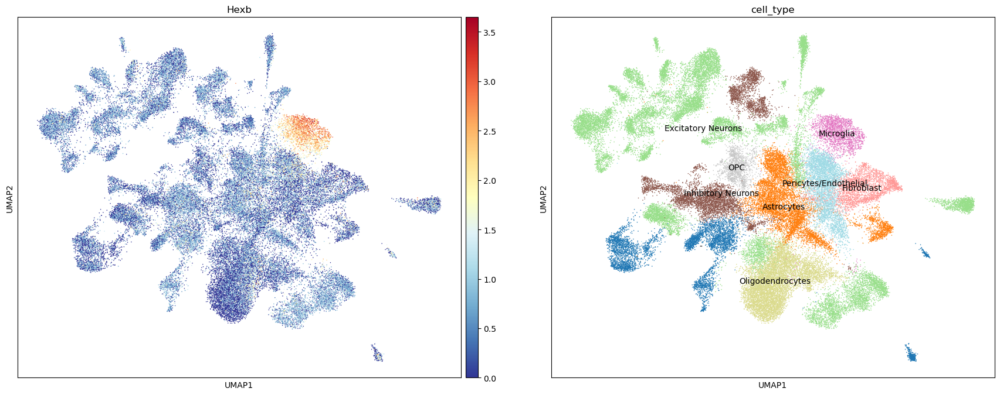

In [60]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.umap(wt_2p5_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


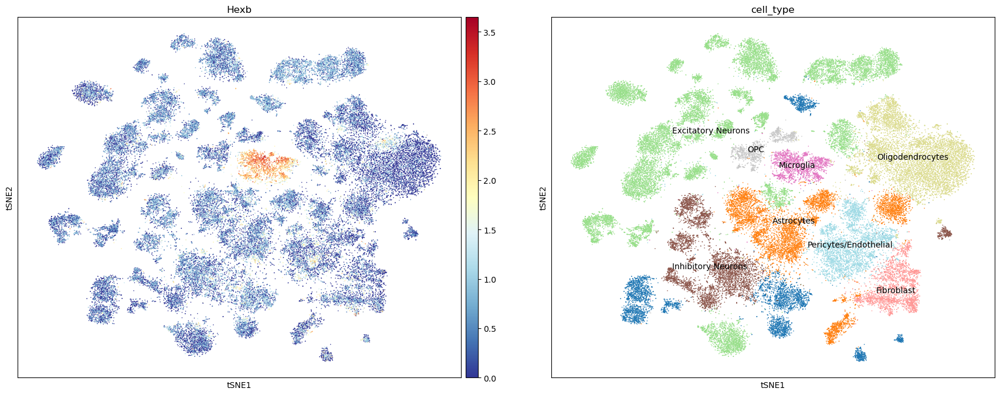

In [77]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.tsne(wt_2p5_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


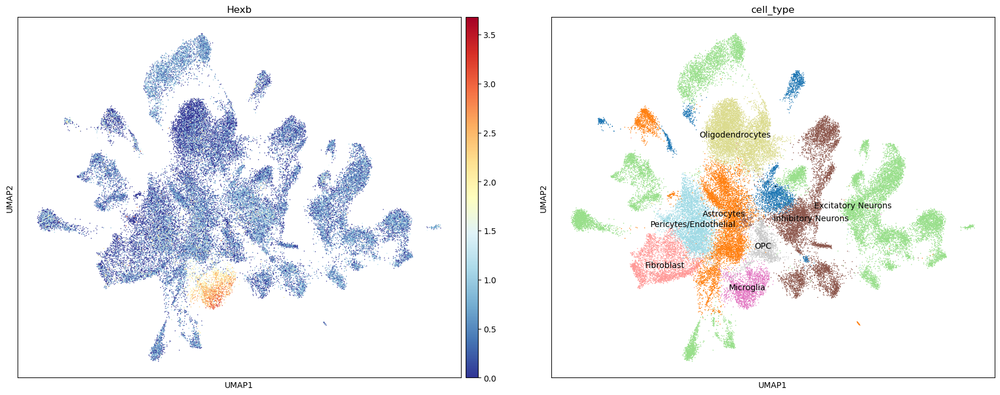

In [64]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.umap(tg_2p5_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


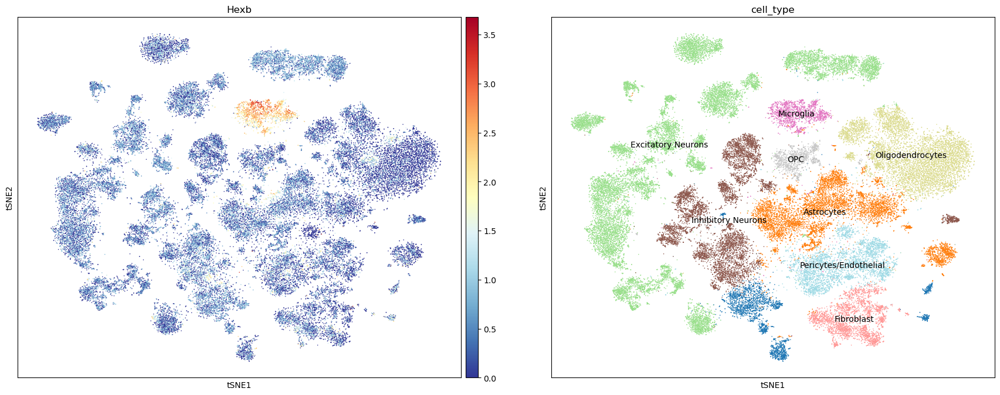

In [78]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.tsne(tg_2p5_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


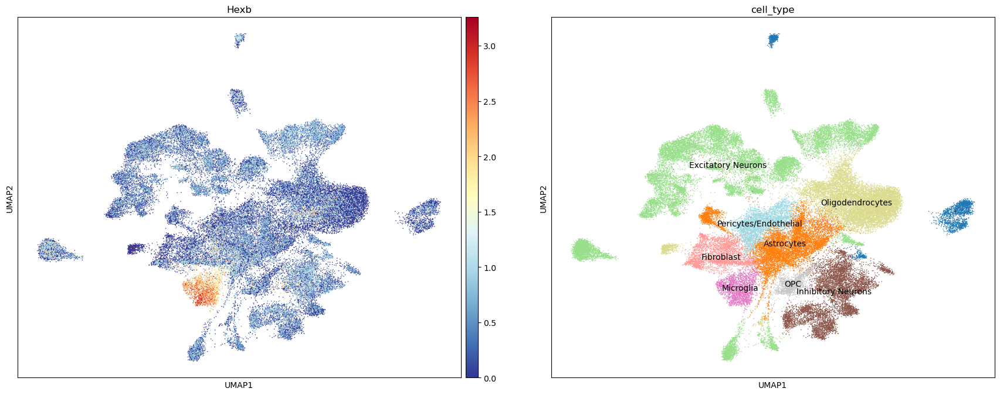

In [65]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.umap(wt_13p4_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


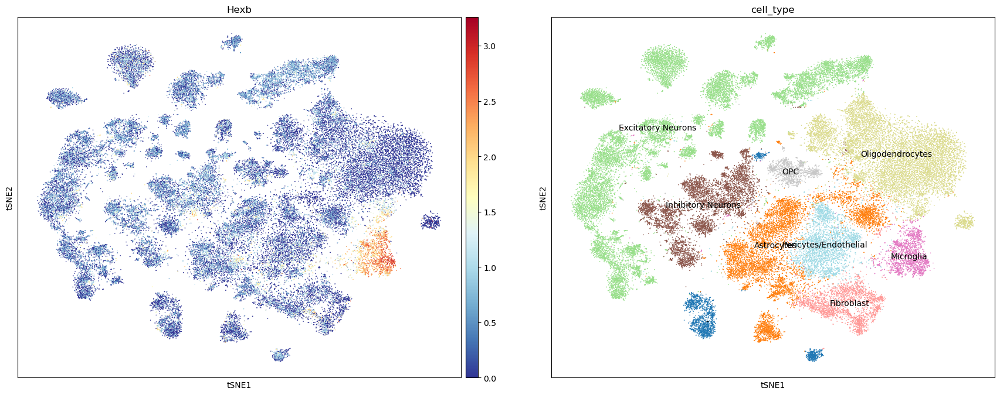

In [79]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.tsne(wt_13p4_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


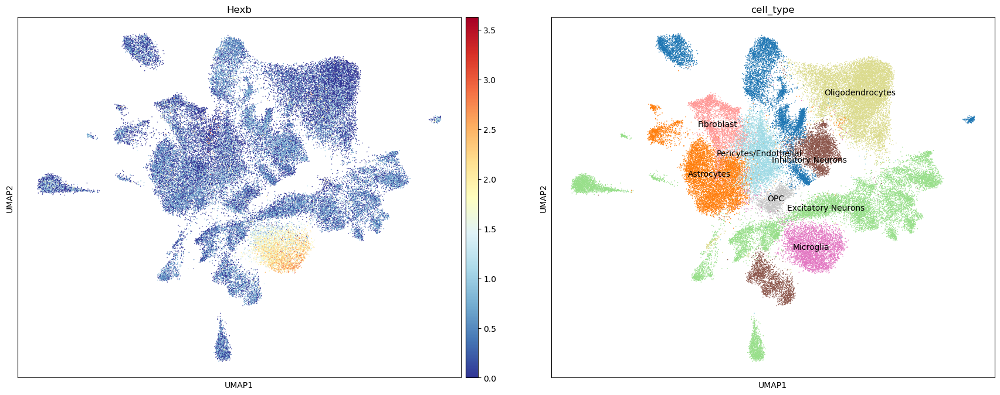

In [72]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.umap(tg_17p9_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r", palette="tab20")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


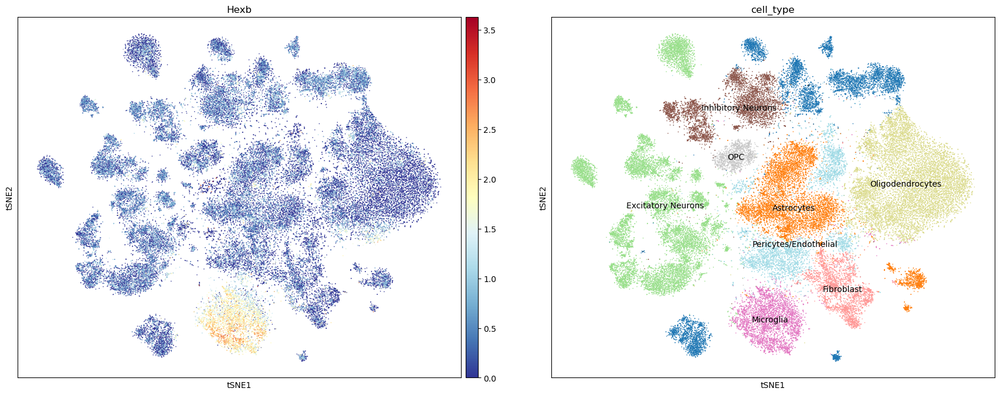

In [80]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.tsne(tg_17p9_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r", palette="tab20")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


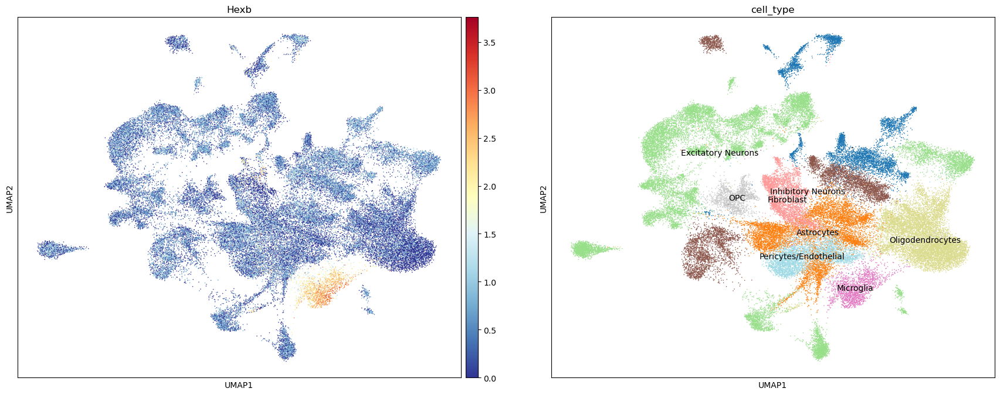

In [100]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.umap(wt_5p7_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


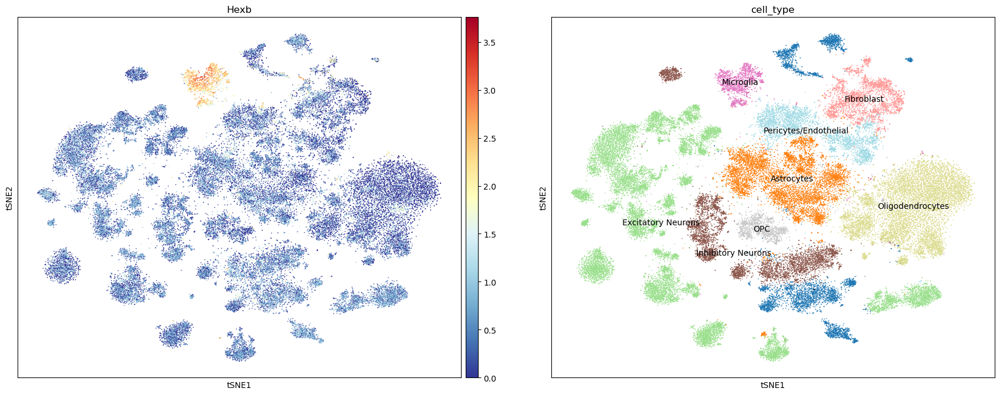

In [101]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.tsne(wt_5p7_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


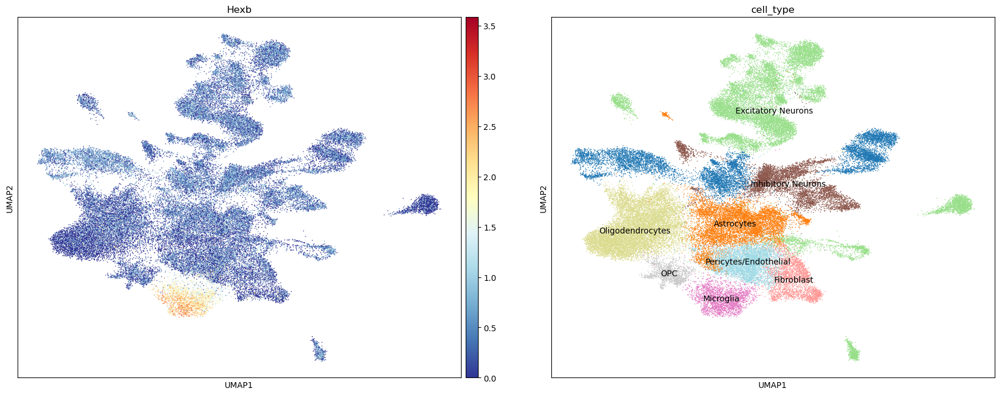

In [102]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.umap(tg_5p7_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


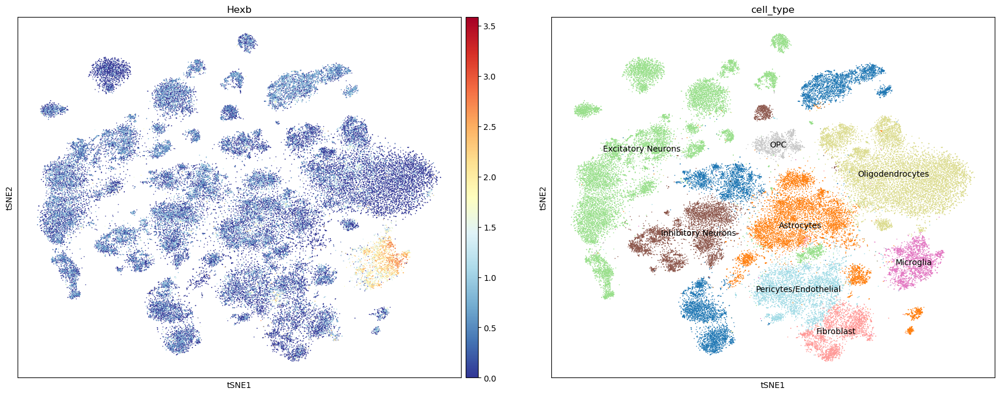

In [103]:
plt.rcParams["figure.figsize"] = (10, 8)
sc.pl.tsne(tg_5p7_adata, color=["Hexb", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:744: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:472: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:650: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_uti

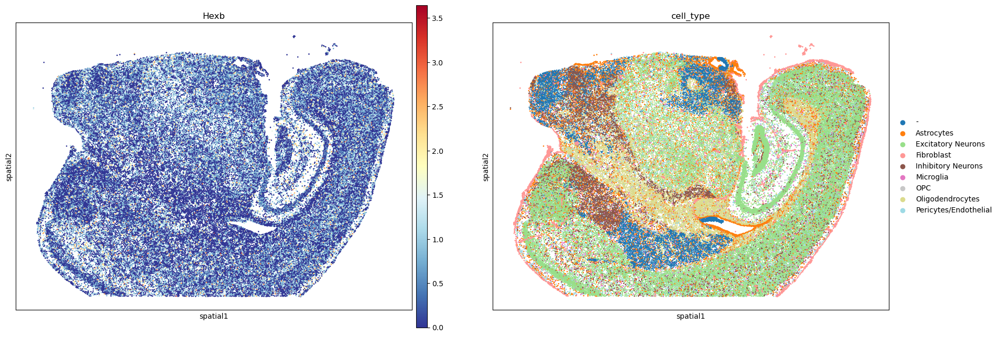

In [73]:
sq.pl.spatial_scatter(wt_2p5_adata, shape=None, color=["Hexb", "cell_type"], library_id="spatial", cmap="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:744: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:472: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:650: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_uti

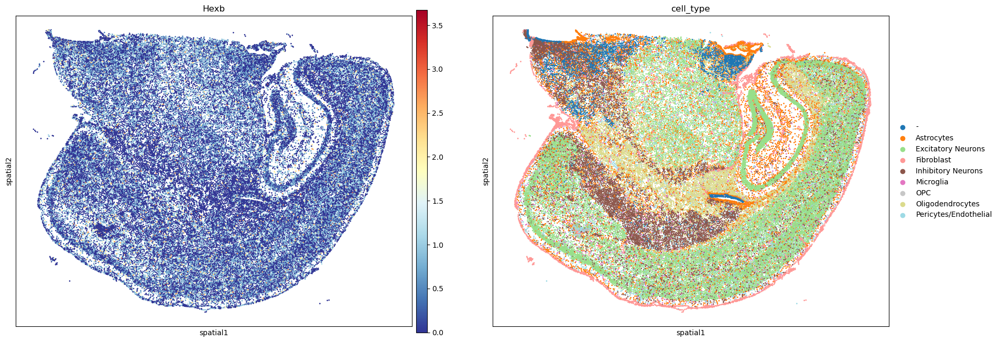

In [74]:
sq.pl.spatial_scatter(tg_2p5_adata, shape=None, color=["Hexb", "cell_type"], library_id="spatial", cmap="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:744: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:472: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:650: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_uti

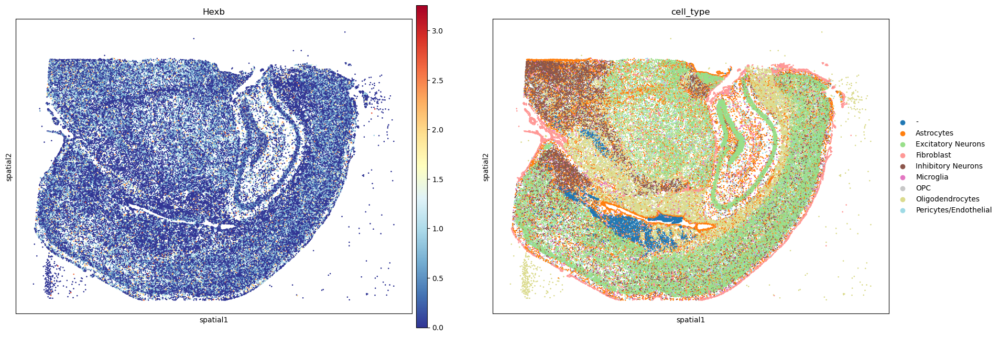

In [75]:
sq.pl.spatial_scatter(wt_13p4_adata, shape=None, color=["Hexb", "cell_type"], library_id="spatial", cmap="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:744: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:472: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:650: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_uti

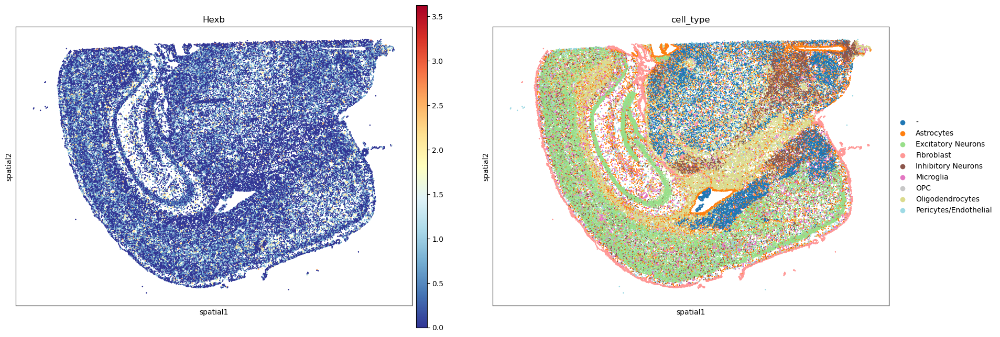

In [76]:
sq.pl.spatial_scatter(tg_17p9_adata, shape=None, color=["Hexb", "cell_type"], library_id="spatial", cmap="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:744: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:472: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:650: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_uti

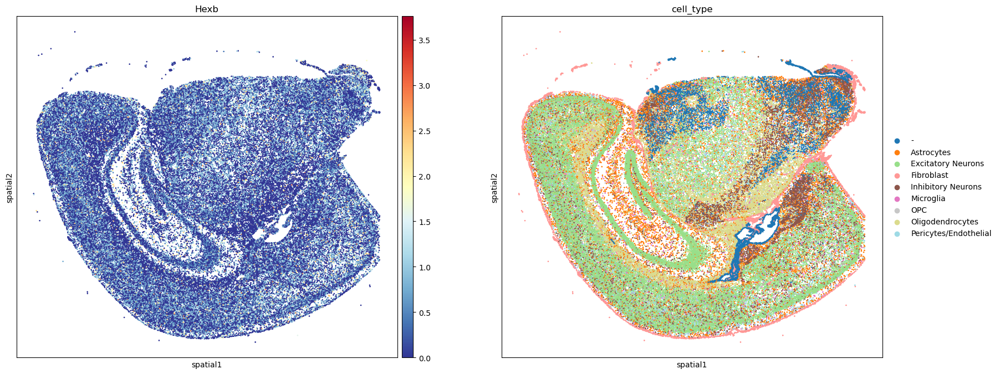

In [104]:
sq.pl.spatial_scatter(wt_5p7_adata, shape=None, color=["Hexb", "cell_type"], library_id="spatial", cmap="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:744: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:472: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:650: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_uti

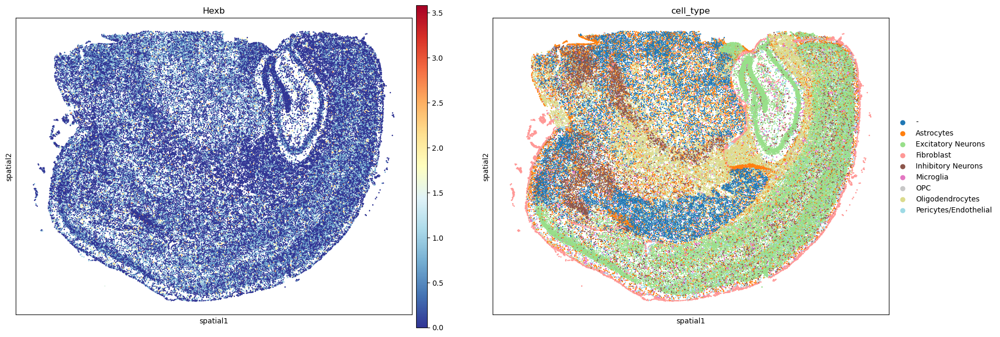

In [105]:
sq.pl.spatial_scatter(tg_5p7_adata, shape=None, color=["Hexb", "cell_type"], library_id="spatial", cmap="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_anndata.py:770: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(adata.obs[groupby]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/categorical.py:641: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python

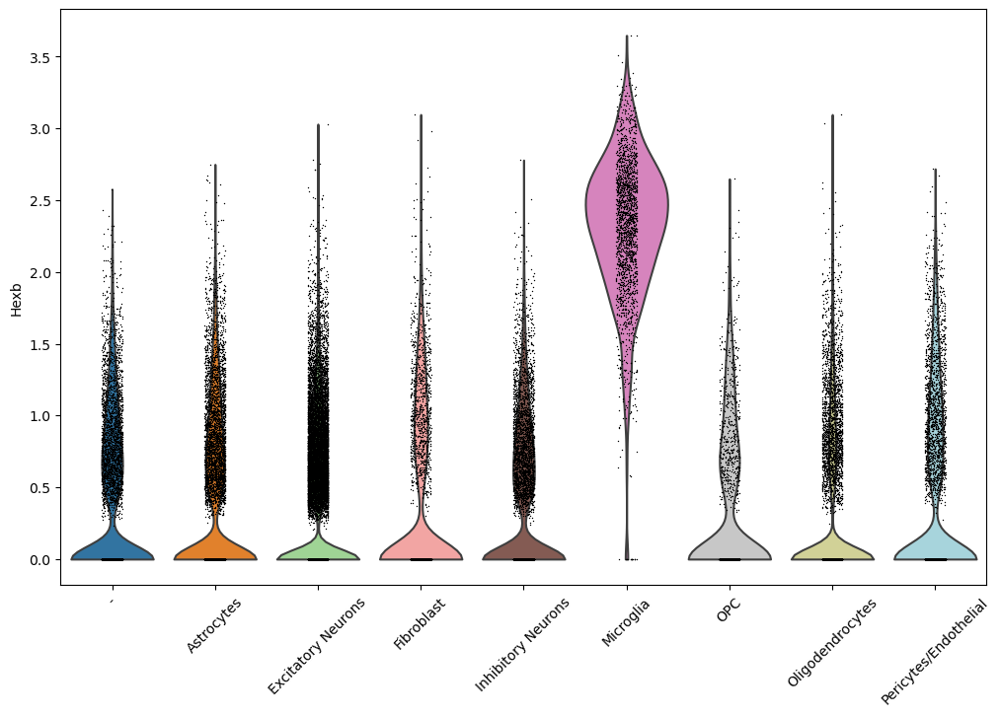

In [92]:
sc.pl.violin(wt_2p5_adata, "Hexb", groupby="cell_type", rotation=45)

Verify difference in Hexb expression across the different samples

In [107]:
adata_list = [wt_2p5_adata, tg_2p5_adata, wt_5p7_adata, tg_5p7_adata, wt_13p4_adata, tg_17p9_adata]

In [124]:
adata_names = ["wt_2p5", "tg_2p5", "wt_5p7", "tg_5p7", "wt_13p4", "tg_17p9"]

In [108]:
cell_type = "Microglia"
gene = "Hexb"

In [122]:
# Filter cells by cell type
selected_cells = []
for adata in adata_list:
    selected_cells.append(adata[adata.obs["cell_type"] == cell_type].obs_names)

In [126]:
# Extract gene expression for selected cells
gene_expression_data = []
for adata, cells in zip(adata_list, selected_cells):
    gene_expression_data.append(adata[cells].obs_vector(gene))

In [140]:
# Combine data in long-form for plotting
df = pd.DataFrame(columns=["sample", "gene_expression"])
sample_col, gene_expression_col = [], []
for ind, sample in enumerate(gene_expression_data):
    sample_col.extend([adata_names[ind]] * len(sample))
    gene_expression_col.extend(sample)
df["sample"], df["gene_expression"] = sample_col, gene_expression_col

In [160]:
df["group"] = df["sample"].apply(lambda x: "Wild type" if x.split("_")[0] == "wt" else "TgCRND8")
df["timepoint"] = df["sample"].apply(lambda x: "2.5" if x.split("_")[1] == "2p5" else ("5.7" if x.split("_")[1] == "5p7" else "13+"))

In [199]:
df

,sample,gene_expression,group,timepoint
0,wt_2p5,2.552445,Wild type,2.5
1,wt_2p5,2.659494,Wild type,2.5
2,wt_2p5,2.183923,Wild type,2.5
3,wt_2p5,2.051736,Wild type,2.5
4,wt_2p5,1.942391,Wild type,2.5
...,...,...,...,...
14202,tg_17p9,0.715747,TgCRND8,13+
14203,tg_17p9,1.853537,TgCRND8,13+
14204,tg_17p9,1.887379,TgCRND8,13+
14205,tg_17p9,0.801189,TgCRND8,13+


In [201]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14207 entries, 0 to 14206
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   sample           14207 non-null  object 
 1   gene_expression  14207 non-null  float32
 2   group            14207 non-null  object 
 3   timepoint        14207 non-null  object 
dtypes: float32(1), object(3)
memory usage: 388.6+ KB


In [148]:
sns.set_style("whitegrid")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and w

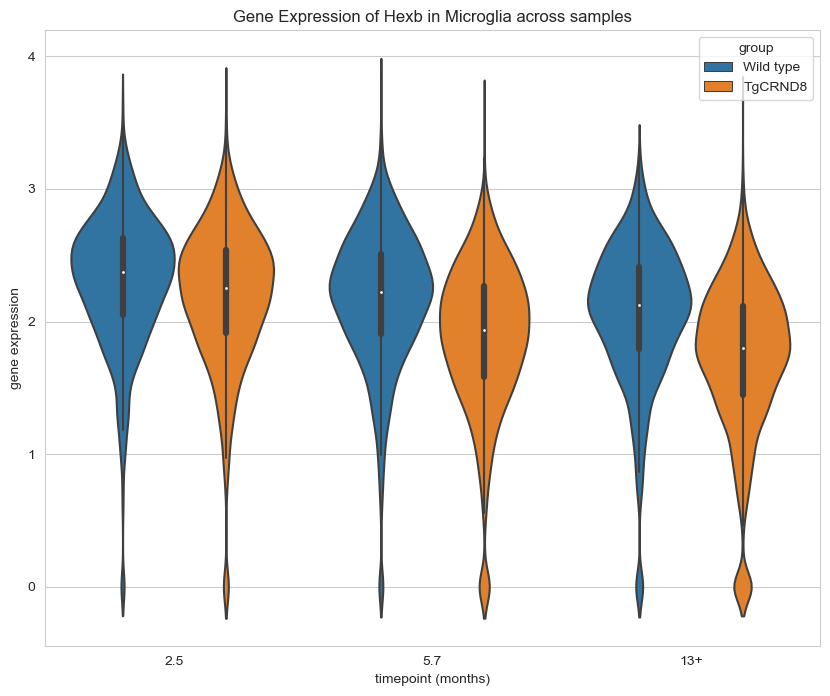

In [168]:
# Plot violin plot
sns.violinplot(data=df, x="timepoint", y="gene_expression", hue="group")
plt.title(f"Gene Expression of {gene} in {cell_type} across samples")
plt.xlabel("timepoint (months)")
plt.ylabel("gene expression")
plt.show()

In [218]:
wt_df = df[df["group"] == "Wild type"]
tg_df = df[df["group"] == "TgCRND8"]

In [220]:
# t-test to compare gene expression across treatment groups
ttest_ind(wt_df["gene_expression"], tg_df["gene_expression"], alternative="two-sided").pvalue

2.244182000560641e-218

In [225]:
ttest_ind(wt_df["gene_expression"], tg_df["gene_expression"], alternative="greater").pvalue

1.1220910002803205e-218

In [219]:
# ANOVA to compare gene expression across timepoints within treatment groups
F_wt, p_wt = f_oneway(wt_df[wt_df["timepoint"] == "2.5"]["gene_expression"], 
                wt_df[wt_df["timepoint"] == "5.7"]["gene_expression"], 
                wt_df[wt_df["timepoint"] == "13+"]["gene_expression"])

F_tg, p_tg = f_oneway(tg_df[tg_df["timepoint"] == "2.5"]["gene_expression"], 
                tg_df[tg_df["timepoint"] == "5.7"]["gene_expression"], 
                tg_df[tg_df["timepoint"] == "13+"]["gene_expression"])

print(f"p-value for wild type samples: {p_wt}")
print(f"p-value for TgCRND8 samples: {p_tg}")

p-value for wild type samples: 4.247338639342446e-53
p-value for TgCRND8 samples: 5.673214451050373e-172


### Functions

In [221]:
def create_df(cell_type, gene):
    """ Creates a DataFrame with gene expression values of the selected cell type and gene """
    # Filter cells by cell type
    selected_cells = []
    for adata in adata_list:
        selected_cells.append(adata[adata.obs["cell_type"] == cell_type].obs_names)

    # Extract gene expression for selected cells
    gene_expression_data = []
    for adata, cells in zip(adata_list, selected_cells):
        gene_expression_data.append(adata[cells].obs_vector(gene))

    # Combine data in long-form for plotting
    df = pd.DataFrame(columns=["sample", "gene_expression"])
    sample_col, gene_expression_col = [], []
    for ind, sample in enumerate(gene_expression_data):
        sample_col.extend([adata_names[ind]] * len(sample))
        gene_expression_col.extend(sample)
    df["sample"], df["gene_expression"] = sample_col, gene_expression_col
    df["group"] = df["sample"].apply(lambda x: "Wild type" if x.split("_")[0] == "wt" else "TgCRND8")
    df["timepoint"] = df["sample"].apply(lambda x: "2.5" if x.split("_")[1] == "2p5" else ("5.7" if x.split("_")[1] == "5p7" else "13+"))
    return df

In [222]:
def plot_exp_across_samples(cell_type, gene):
    """ Plots violin plot of gene expression across samples for the selected cell type and gene """
    df = create_df(cell_type, gene)
    sns.violinplot(data=df, x="timepoint", y="gene_expression", hue="group")
    plt.title(f"Gene Expression of {gene} in {cell_type} across samples")
    plt.xlabel("timepoint (months)")
    plt.ylabel("gene expression")
    plt.show()

In [226]:
def get_pvals(cell_type, gene, hypothesis="two-sided"):
    """ Runs appropriate statistical tests on gene expression data for the selected cell type and gene and prints the resultant p-values """
    df = create_df(cell_type, gene)
    wt_df = df[df["group"] == "Wild type"]
    tg_df = df[df["group"] == "TgCRND8"]
    
    # t-test to compare gene expression across treatment groups
    p_ttest = ttest_ind(wt_df["gene_expression"], tg_df["gene_expression"], alternative=hypothesis).pvalue

    # ANOVA to compare gene expression across timepoints within treatment groups
    F_wt, p_wt = f_oneway(wt_df[wt_df["timepoint"] == "2.5"]["gene_expression"], 
                    wt_df[wt_df["timepoint"] == "5.7"]["gene_expression"], 
                    wt_df[wt_df["timepoint"] == "13+"]["gene_expression"])

    F_tg, p_tg = f_oneway(tg_df[tg_df["timepoint"] == "2.5"]["gene_expression"], 
                    tg_df[tg_df["timepoint"] == "5.7"]["gene_expression"], 
                    tg_df[tg_df["timepoint"] == "13+"]["gene_expression"])

    print(f"p-value across treatment groups: {p_ttest}")
    print(f"p-value for wild type samples: {p_wt}")
    print(f"p-value for TgCRND8 samples: {p_tg}")

### Gja1

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

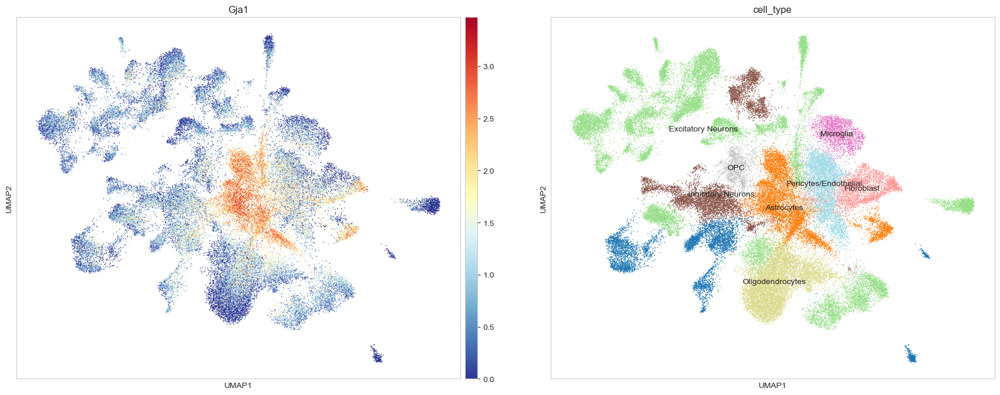

In [170]:
plt.figure(figsize=(10, 8))
sc.pl.umap(wt_2p5_adata, color=["Gja1", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:744: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:472: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:650: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_uti

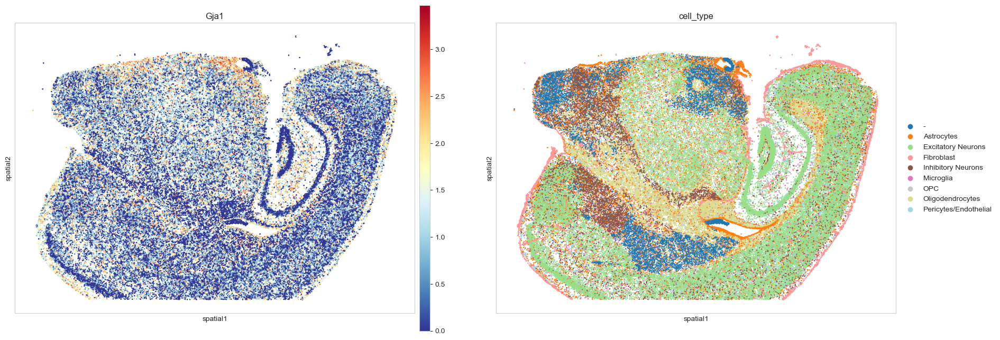

In [172]:
sq.pl.spatial_scatter(wt_2p5_adata, shape=None, color=["Gja1", "cell_type"], library_id="spatial", cmap="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

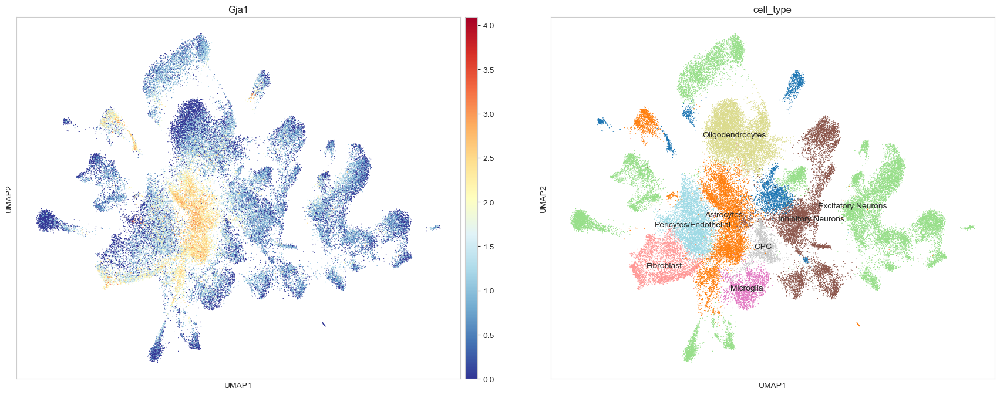

In [173]:
plt.figure(figsize=(10, 8))
sc.pl.umap(tg_2p5_adata, color=["Gja1", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

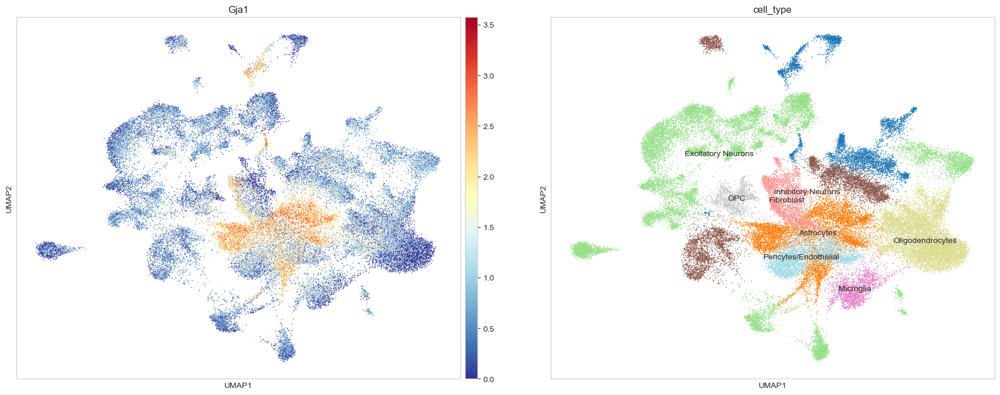

In [174]:
plt.figure(figsize=(10, 8))
sc.pl.umap(wt_5p7_adata, color=["Gja1", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

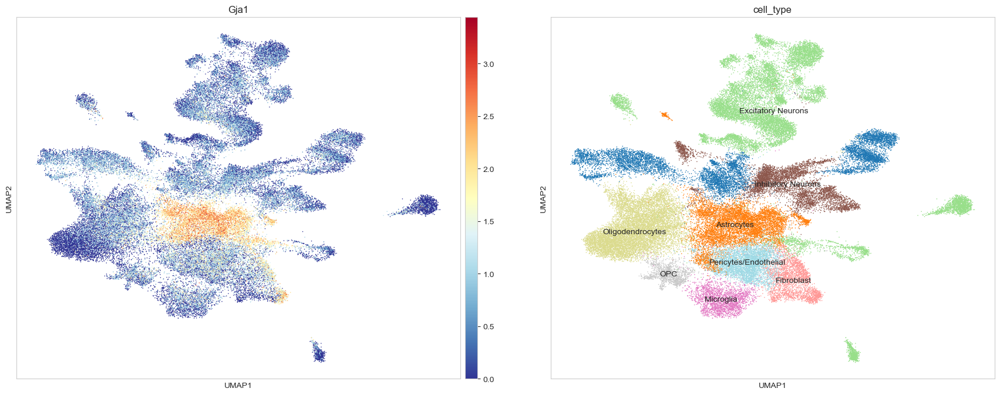

In [175]:
plt.figure(figsize=(10, 8))
sc.pl.umap(tg_5p7_adata, color=["Gja1", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

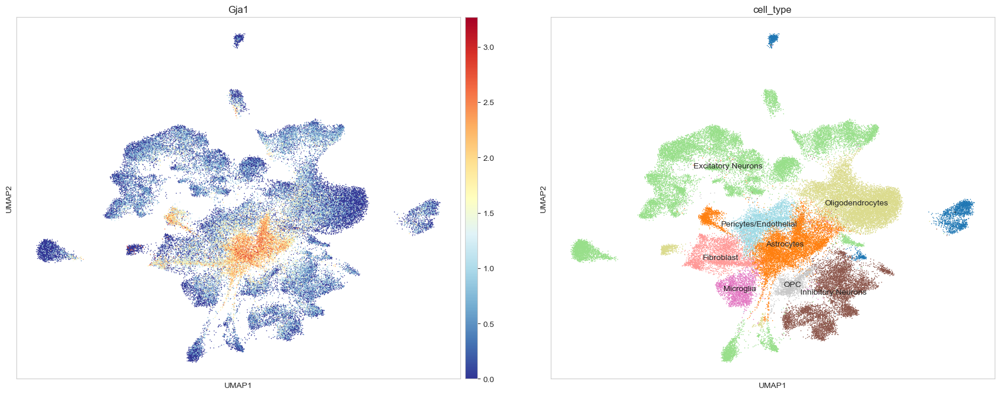

In [176]:
plt.figure(figsize=(10, 8))
sc.pl.umap(wt_13p4_adata, color=["Gja1", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:744: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:472: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:650: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_uti

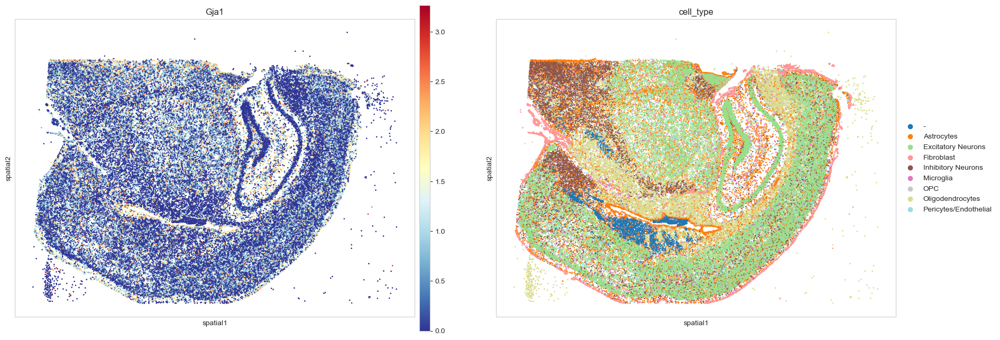

In [203]:
sq.pl.spatial_scatter(wt_13p4_adata, shape=None, color=["Gja1", "cell_type"], library_id="spatial", cmap="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

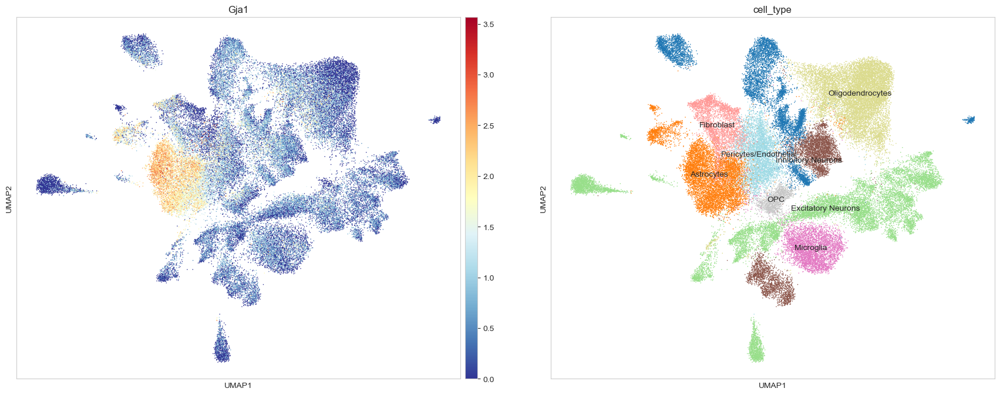

In [177]:
plt.figure(figsize=(10, 8))
sc.pl.umap(tg_17p9_adata, color=["Gja1", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and w

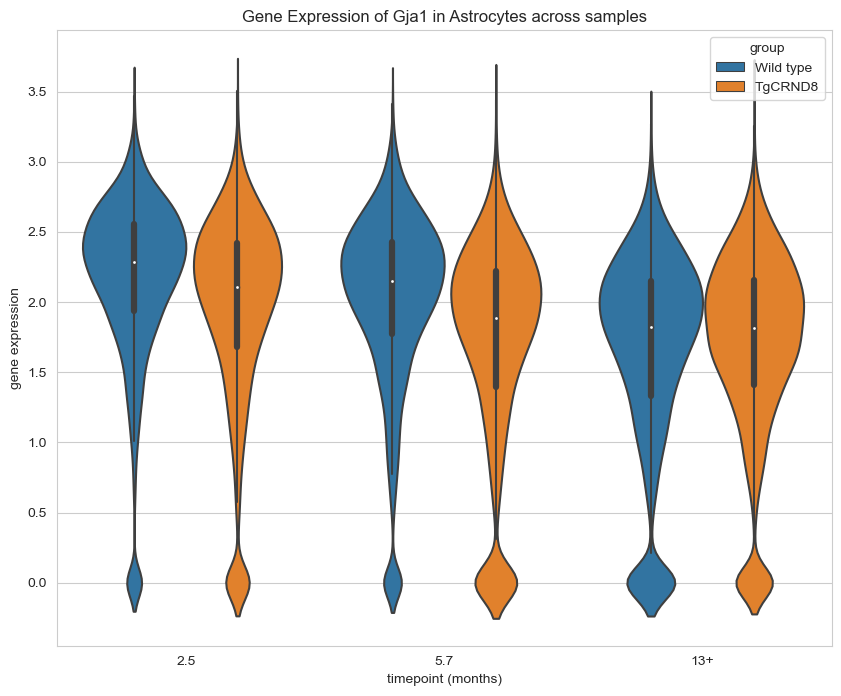

In [178]:
plot_exp_across_samples("Astrocytes", "Gja1")

In [227]:
get_pvals("Astrocytes", "Gja1", "two-sided")

p-value across treatment groups: 1.0899191698443087e-115
p-value for wild type samples: 0.0
p-value for TgCRND8 samples: 5.445486059427513e-137


In [228]:
get_pvals("Astrocytes", "Gja1", "greater")

p-value across treatment groups: 5.449595849221544e-116
p-value for wild type samples: 0.0
p-value for TgCRND8 samples: 5.445486059427513e-137


### Trem2

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

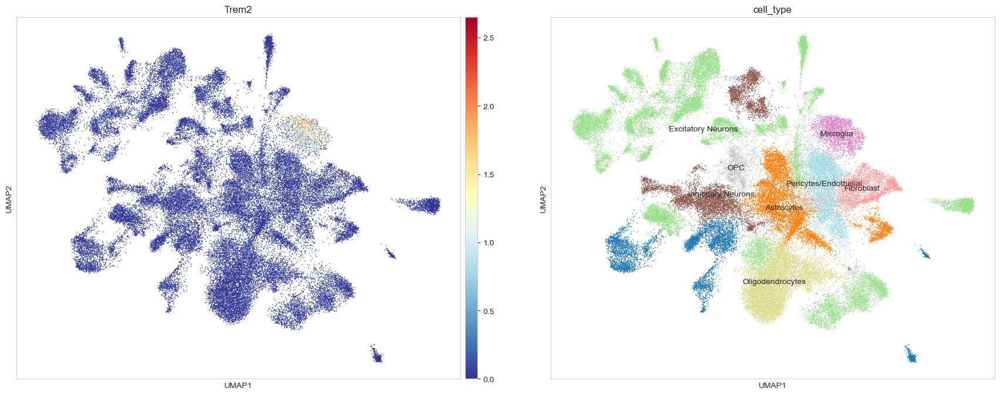

In [179]:
plt.figure(figsize=(10, 8))
sc.pl.umap(wt_2p5_adata, color=["Trem2", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

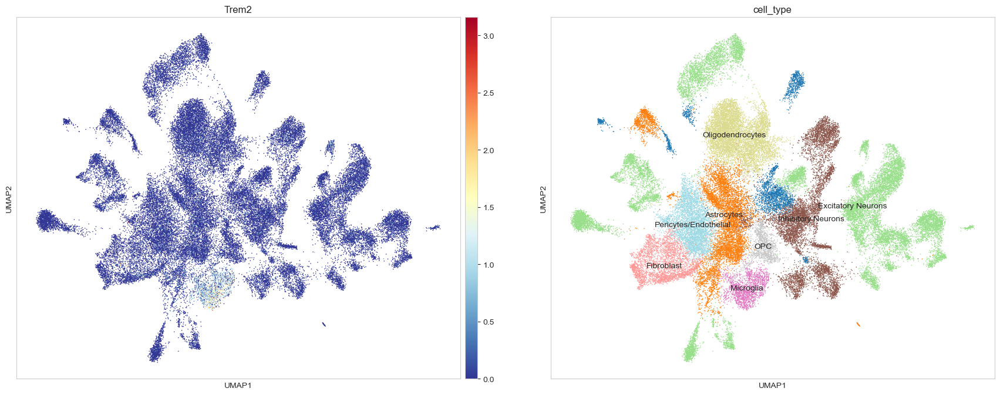

In [180]:
plt.figure(figsize=(10, 8))
sc.pl.umap(tg_2p5_adata, color=["Trem2", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

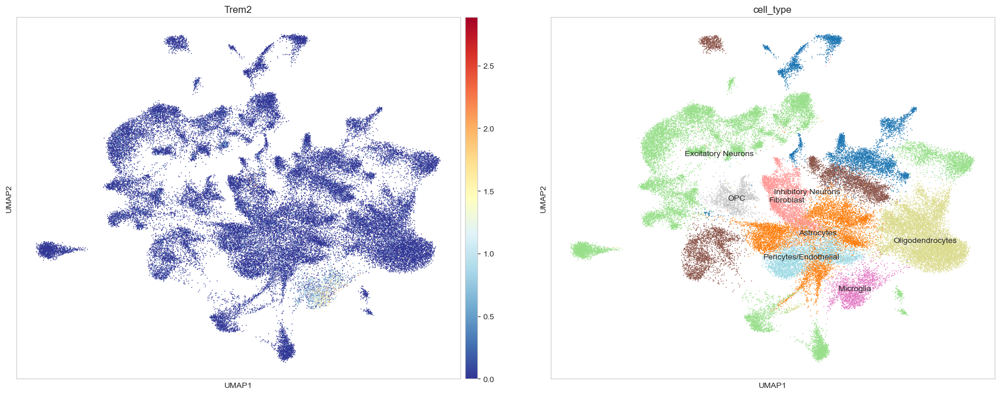

In [181]:
plt.figure(figsize=(10, 8))
sc.pl.umap(wt_5p7_adata, color=["Trem2", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

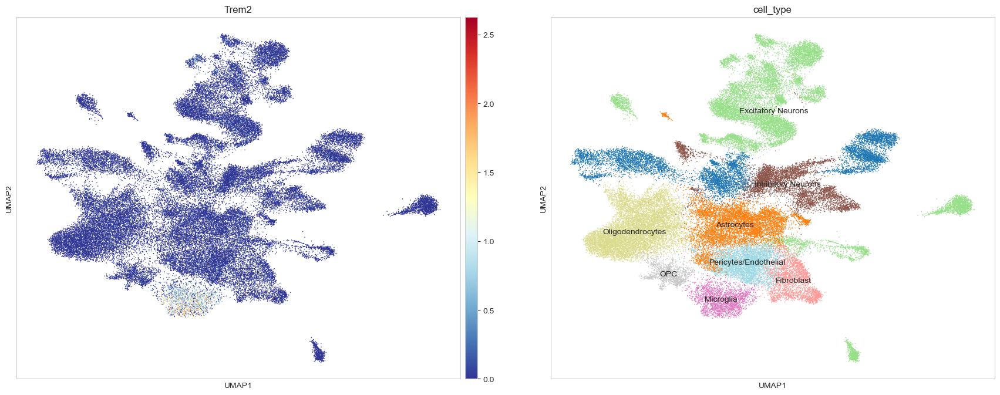

In [182]:
plt.figure(figsize=(10, 8))
sc.pl.umap(tg_5p7_adata, color=["Trem2", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

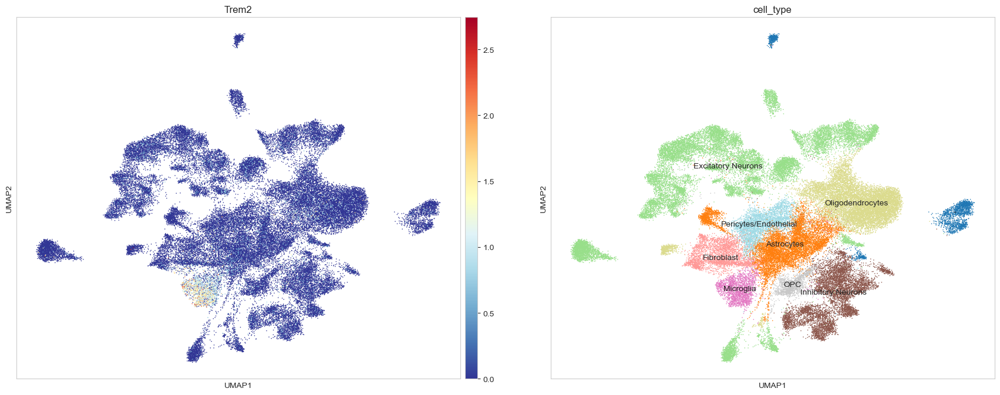

In [183]:
plt.figure(figsize=(10, 8))
sc.pl.umap(wt_13p4_adata, color=["Trem2", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

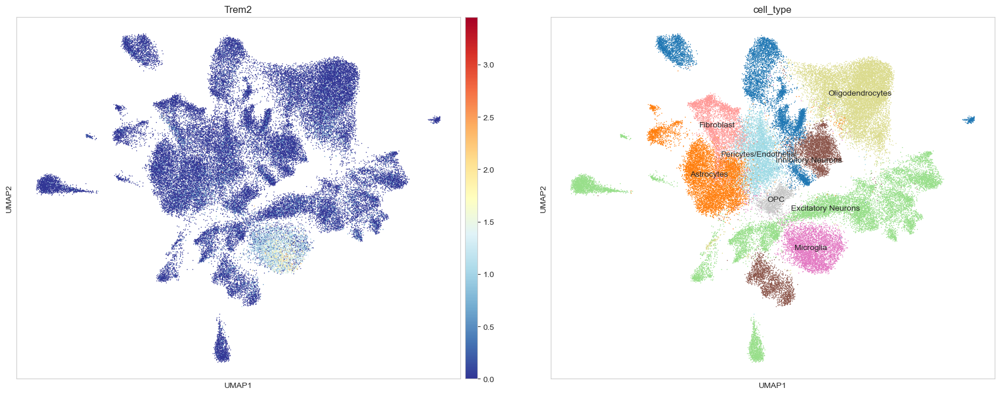

In [184]:
plt.figure(figsize=(10, 8))
sc.pl.umap(tg_17p9_adata, color=["Trem2", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and w

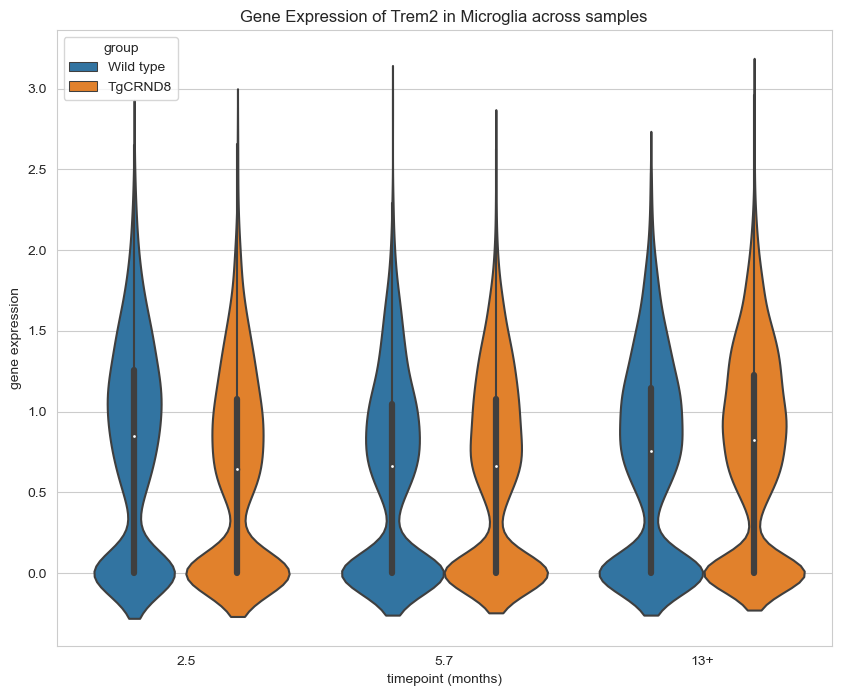

In [185]:
plot_exp_across_samples("Microglia", "Trem2")

In [229]:
get_pvals("Microglia", "Trem2", "two-sided")

p-value across treatment groups: 0.9534085229545597
p-value for wild type samples: 3.0443901788400855e-15
p-value for TgCRND8 samples: 2.4311905090566766e-25


### Apoe

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

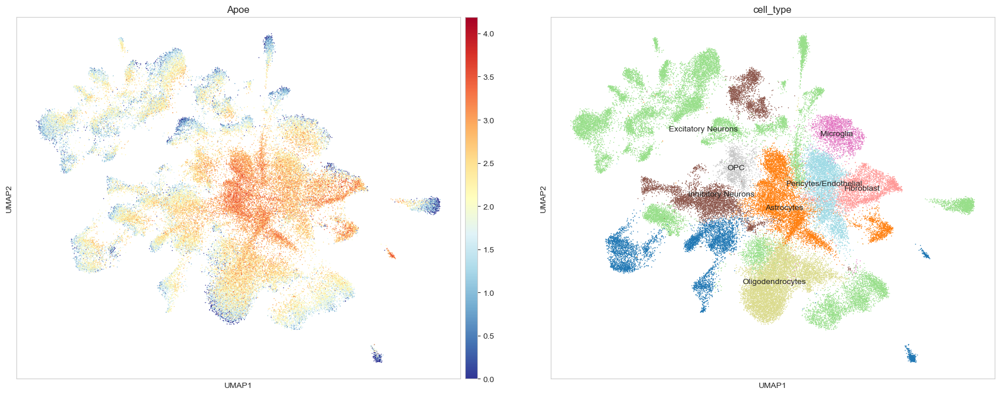

In [191]:
plt.figure(figsize=(10, 8))
sc.pl.umap(wt_2p5_adata, color=["Apoe", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:744: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if c is not None and c in adata.obs and is_categorical_dtype(adata.obs[c]):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:472: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_utils.py:650: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if is_categorical_dtype(color_source_vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/squidpy/pl/_spatial_uti

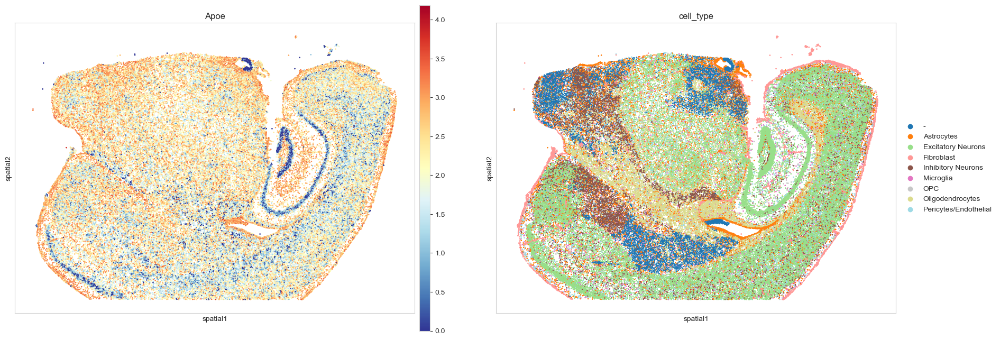

In [192]:
sq.pl.spatial_scatter(wt_2p5_adata, shape=None, color=["Apoe", "cell_type"], library_id="spatial", cmap="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

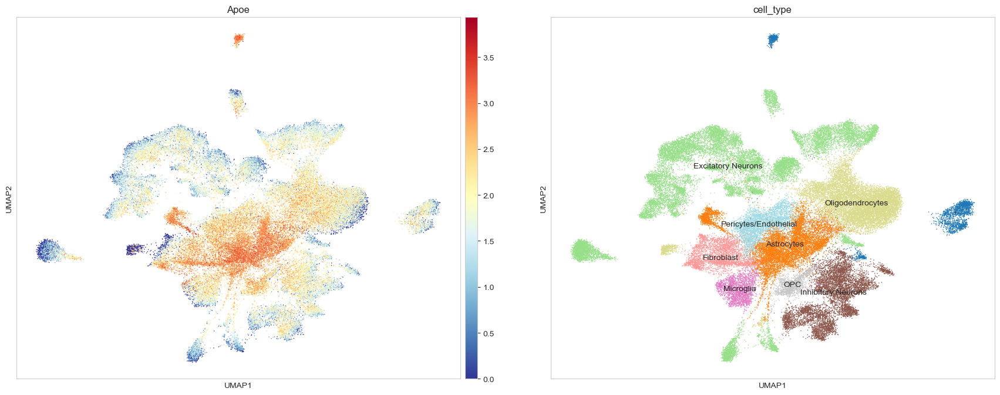

In [204]:
plt.figure(figsize=(10, 8))
sc.pl.umap(wt_13p4_adata, color=["Apoe", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1207: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1216: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


<Figure size 1000x800 with 0 Axes>

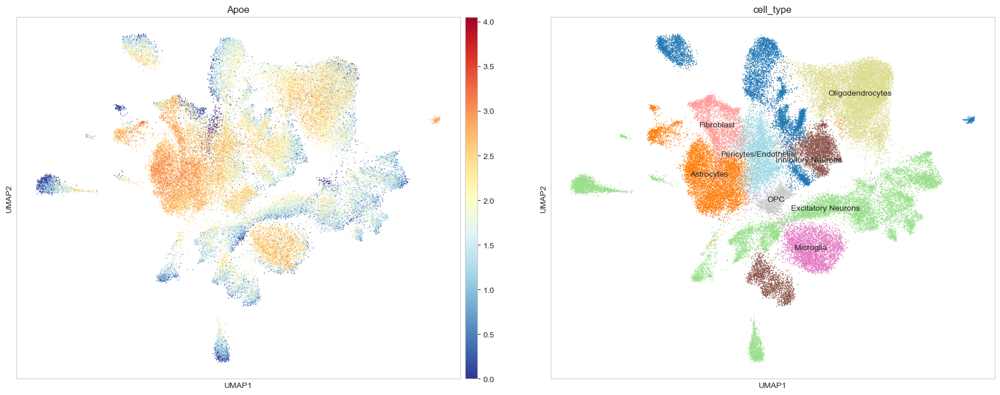

In [193]:
plt.figure(figsize=(10, 8))
sc.pl.umap(tg_17p9_adata, color=["Apoe", "cell_type"], legend_loc="on data", legend_fontsize="medium", legend_fontweight="light", size=5, color_map="RdYlBu_r")

/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and w

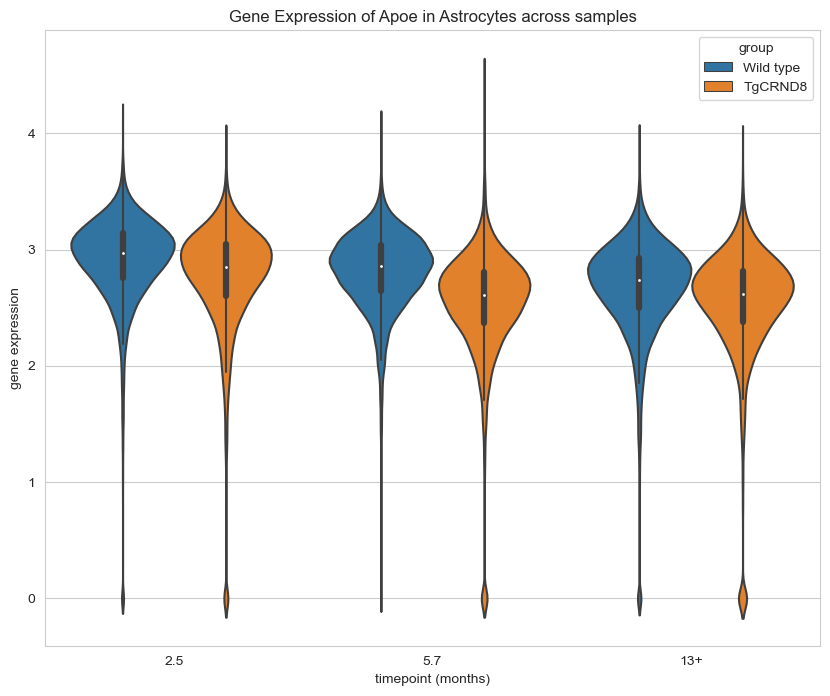

In [194]:
plot_exp_across_samples("Astrocytes", "Apoe")

In [230]:
get_pvals("Astrocytes", "Apoe", "two-sided")

p-value across treatment groups: 0.0
p-value for wild type samples: 0.0
p-value for TgCRND8 samples: 5.767378259848251e-234


In [231]:
get_pvals("Astrocytes", "Apoe", "greater")

p-value across treatment groups: 0.0
p-value for wild type samples: 0.0
p-value for TgCRND8 samples: 5.767378259848251e-234


/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/phoebe/opt/anaconda3/envs/spatial/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and w

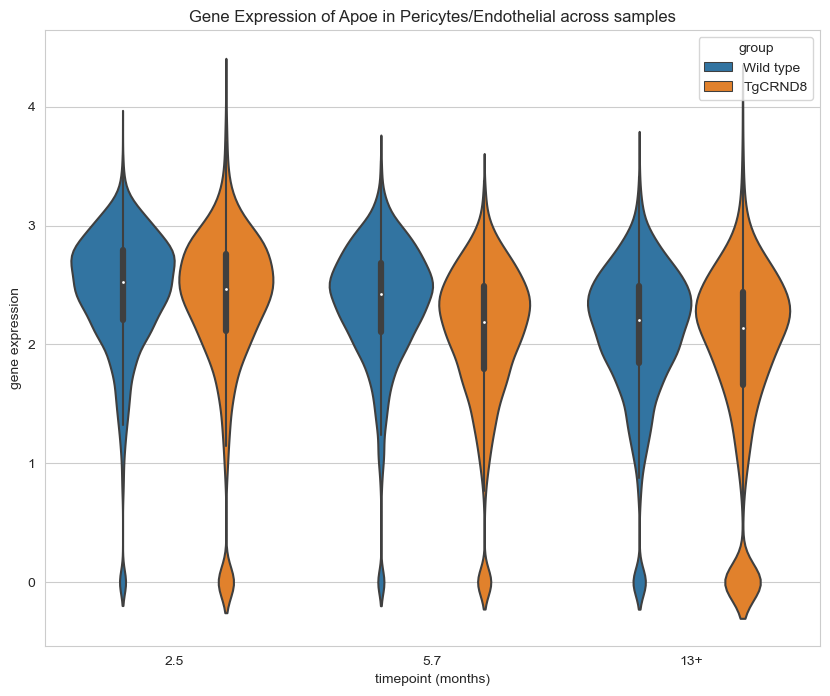

In [196]:
plot_exp_across_samples("Pericytes/Endothelial", "Apoe")

In [232]:
get_pvals("Pericytes/Endothelial", "Apoe", "two-sided")

p-value across treatment groups: 8.079941959841161e-126
p-value for wild type samples: 1.2510307551369754e-170
p-value for TgCRND8 samples: 3.034927769809255e-169


In [233]:
get_pvals("Pericytes/Endothelial", "Apoe", "greater")

p-value across treatment groups: 4.039970979920581e-126
p-value for wild type samples: 1.2510307551369754e-170
p-value for TgCRND8 samples: 3.034927769809255e-169
